In [1]:
from scipy.ndimage import gaussian_filter
from scipy.signal import butter, sosfiltfilt
import numpy as np
import matplotlib.pyplot as plt
import math

In [2]:
def analytic_signal_fft_nd(x, axis=-1):
    """
    FFT-based Hilbert transform to get analytic signal along a given axis.
    Works for real x with arbitrary extra dims.
    Returns complex analytic signal with same shape.
    """
    x = np.asarray(x)
    n = x.shape[axis]
    X = np.fft.fft(x, n=n, axis=axis)
    h = np.zeros(n, dtype=float)
    if n % 2 == 0:
        h[0] = 1.0
        h[n//2] = 1.0
        h[1:n//2] = 2.0
    else:
        h[0] = 1.0
        h[1:(n+1)//2] = 2.0
    # reshape h to broadcast along 'axis'
    shape = [1]*x.ndim
    shape[axis] = n
    H = h.reshape(shape)
    Z = np.fft.ifft(X * H, axis=axis)
    return Z

# --------- 1) Bandpass along time (axis=2) ----------
def bandpass(movie, Fs, lo=4.0, hi=8.0, order=4):
    """
    Zero-phase bandpass of 'movie' along time axis (axis=2).
    """
    nyq = 0.5 * Fs
    sos = butter(order, [lo/nyq, hi/nyq], btype='bandpass', output='sos')
    return sosfiltfilt(sos, movie, axis=2)


# --------- 2) Analytic signal → amplitude & phase ----------
def phase_amp(movie_bp):
    """
    Compute analytic signal per pixel along time axis:
      z = x + i * Hilbert(x)
      amp = |z|
      phi = angle(z) in (-π, π]
    """
    z = analytic_signal_fft_nd(movie_bp, axis=2)
    amp = np.abs(z)
    phi = np.angle(z)
    return amp, phi

def smooth_phase_gaussian(z, amp=None, sigma_px=1.5, truncate=3.0, mode='reflect'):
    """
    Wrap-safe spatial smoothing of phase using the complex field.

    Parameters
    ----------
    z : complex array, shape (ny, nx, nt)
        Analytic signal. (From your FFT-Hilbert.)
    amp : float array, same shape as |z| (optional)
        If provided, we remove amplitude to avoid bias (recommended).
    sigma_px : float
        Spatial Gaussian sigma in pixels (gentle: 1.0–2.0 typical).
    truncate, mode : as in scipy.ndimage.gaussian_filter.

    Returns
    -------
    phi_s : float array (ny, nx, nt)
        Wrapped, gently smoothed phase.
    z_s   : complex array (ny, nx, nt)
        Smoothed *unit* complex field used to derive phi_s.
    """
    # Use unit phasors to avoid amplitude bias during smoothing
    if amp is None:
        amp = np.abs(z)
    eps = 1e-12
    z_unit = z / (amp + eps)

    # Smooth only in space (y,x), not time (t)
    z_s = gaussian_filter(z_unit, sigma=(sigma_px, sigma_px, 0.0),
                          truncate=truncate, mode=mode)

    # Convert back to wrapped phase
    phi_s = np.angle(z_s)
    return phi_s, z_s

def phase_gradient_from_complex(z_like, dx=1.0, dy=1.0):
    """
    Compute wrap-safe spatial phase gradients using complex products.

    Idea (Muller): the phase difference between neighboring samples equals
        Δφ = angle( Z_neighbor * conj(Z_here) )
    so we never unwrap.

    Parameters
    ----------
    z_like : complex array, shape (ny, nx, nt)
        Complex field with phase we want the gradient of.
        (Use the smoothed unit field z_s from above for robustness.)
    dx, dy : float
        Pixel spacings in x and y (defaults = 1).

    Returns
    -------
    gx, gy : float arrays, shape (ny, nx, nt)
        Forward-difference estimates of ∂φ/∂x and ∂φ/∂y (radians per pixel).
        Edges (last col/row) are set to NaN.
    """
    ny, nx, nt = z_like.shape

    # x-gradient: compare (x+1,y) to (x,y)
    z_xp1 = np.roll(z_like, -1, axis=1)
    dphi_x = np.angle(z_xp1 * np.conj(z_like))  # φ(x+1)-φ(x)
    gx = dphi_x / dx
    gx[:, -1, :] = np.nan  # invalidate wraparound column

    # y-gradient: compare (x,y+1) to (x,y)
    z_yp1 = np.roll(z_like, -1, axis=0)
    dphi_y = np.angle(z_yp1 * np.conj(z_like))  # φ(y+1)-φ(y)
    gy = dphi_y / dy
    gy[-1, :, :] = np.nan  # invalidate wraparound row

    return -gx, -gy

def divergence(gx, gy, dx=1.0, dy=1.0):
    """
    Divergence of the phase-gradient field g = (gx, gy):
        div = d(gx)/dx + d(gy)/dy
    Uses centered finite differences on the interior; edges -> NaN.

    Parameters
    ----------
    gx, gy : float arrays, shape (ny, nx, nt)
        Phase gradient components (radians/pixel).
    dx, dy : float
        Pixel spacings in x and y.

    Returns
    -------
    div : float array, shape (ny, nx, nt)
        Divergence (radians/pixel^2).
    """
    # Centered differences via roll; we'll invalidate borders afterward
    d_gx_dx = (np.roll(gx, -1, axis=1) - np.roll(gx,  1, axis=1)) / (2.0 * dx)
    d_gy_dy = (np.roll(gy, -1, axis=0) - np.roll(gy,  1, axis=0)) / (2.0 * dy)
    div = d_gx_dx + d_gy_dy

    # Invalidate first/last rows/cols that used wrapped neighbors
    div[:,  0, :] = np.nan
    div[:, -1, :] = np.nan
    div[ 0, :, :] = np.nan
    div[-1, :, :] = np.nan
    return div

def curl2d(gx, gy, dx=1.0, dy=1.0):
    """
    2D curl (z-component) of vector field g=(gx, gy):
        curl_z = ∂gy/∂x - ∂gx/∂y
    Centered differences on interior; edges set to NaN.
    Inputs gx, gy are (ny, nx, nt).
    """
    dgy_dx = (np.roll(gy, -1, axis=1) - np.roll(gy, 1, axis=1)) / (2.0 * dx)
    dgx_dy = (np.roll(gx, -1, axis=0) - np.roll(gx, 1, axis=0)) / (2.0 * dy)
    curl = dgy_dx - dgx_dy
    curl[:,  0, :] = np.nan; curl[:, -1, :] = np.nan
    curl[ 0, :, :] = np.nan; curl[-1, :, :] = np.nan
    return curl

def mask_low_amp(z, amp, z_thresh=1.0):
    """
    Mask low-amplitude regions (relative to z-scored amplitude).
    Any voxel with z-scored amplitude < z_thresh is set to NaN in 'z'.
    
    Parameters
    ----------
    z        : complex array (ny, nx, nt)
        Analytic signal.
    amp      : float array, same shape
        Amplitude = |z|.
    z_thresh : float
        Threshold in z-scored amplitude units.
    
    Returns
    -------
    z_masked : complex array
        Copy of z where low-amp regions are set to NaN.
    mask     : boolean array (ny, nx, nt)
        True where kept, False where masked.
    """
    # Z-score amplitude across space at each time point
    mu = np.nanmedian(amp, axis=(0,1), keepdims=True)
    sigma = np.nanstd(amp, axis=(0,1), keepdims=True) + 1e-12
    amp_z = (amp - mu) / sigma

    mask = amp_z >= z_thresh
    z_masked = z.copy().astype(np.complex128)
    z_masked[~mask] = np.nan + 1j*np.nan
    return z_masked, mask

# =========================================================
# 1) Compute-only: returns a results dict (no plotting)
# =========================================================
def analyze_phase(
    movie, Fs,
    lo=4.0, hi=8.0, order=4,
    sigma_px=1.5, truncate=3.0, mode='reflect',
    dx=1.0, dy=1.0,
    amp_mask=False,
    bandpass=True,
    identify_source=True,
):
    """
    End-to-end analysis with the SAME methods as your current function:
      - Optional temporal bandpass (Butterworth, sosfiltfilt)
      - Analytic signal via analytic_signal_fft_nd
      - Amplitude & wrapped phase
      - Wrap-safe smoothing by normalizing to unit-magnitude complex, then Gaussian
      - Phase gradient via complex-product forward differences, sign-flipped (g = -∇φ)
      - Gradient magnitude
      - Divergence via centered differences (interior), borders NaN
      - Curl_z = ∂gy/∂x − ∂gx/∂y via centered differences (interior), borders NaN

    Parameters
    ----------
    movie : (ny, nx, nt) real array
    Fs    : sampling rate (Hz)
    lo, hi, order : temporal bandpass parameters
    sigma_px, truncate, mode : spatial Gaussian params for complex smoothing
    dx, dy : pixel size (x,y)
    amp_mask : bool, apply your mask_low_amp() to z and amp
    bandpass : bool, apply bandpass before analytic signal
    identify_source : bool, compute argmax of divergence per frame for convenience

    Returns
    -------
    results : dict with keys:
        't', 'movie_bp', 'z', 'amp', 'phi', 'z_s', 'phi_s',
        'gx', 'gy', 'grad_mag', 'div', 'curl', 'source'
    """
    ny, nx, nt = movie.shape
    t = np.arange(nt) / Fs

    # ---- 1) Bandpass in time (unchanged method) ----
    if bandpass:
        nyq = 0.5 * Fs
        sos = butter(order, [lo/nyq, hi/nyq], btype='bandpass', output='sos')
        movie_bp = sosfiltfilt(sos, movie, axis=2)
    else:
        movie_bp = movie

    # ---- 2) Analytic signal, amplitude, phase (unchanged) ----
    z = analytic_signal_fft_nd(movie_bp, axis=2)
    amp = np.abs(z)

    # ---- Optional low-amp mask (unchanged) ----
    if amp_mask:
        z, mask = mask_low_amp(z, amp, z_thresh=-0.5)
        amp = np.where(mask, amp, np.nan)

    phi = np.angle(z)

    # ---- 3) Wrap-safe smoothing in complex domain (unchanged) ----
    eps = 1e-12
    z_unit = z / (amp + eps)
    z_s = gaussian_filter(z_unit, sigma=(sigma_px, sigma_px, 0.0),
                          truncate=truncate, mode=mode)
    phi_s = np.angle(z_s)

    # ---- 4) Phase gradient via complex-product forward diffs (unchanged) ----
    # gx ~ angle( z(x+1,y) * conj(z(x,y)) ) / dx ; same for gy, then sign flip for g = -∇φ
    z_xp1 = np.roll(z_s, -1, axis=1)
    dphi_x = np.angle(z_xp1 * np.conj(z_s))
    gx = dphi_x / dx
    gx[:, -1, :] = np.nan  # invalidate forward edge

    z_yp1 = np.roll(z_s, -1, axis=0)
    dphi_y = np.angle(z_yp1 * np.conj(z_s))
    gy = dphi_y / dy
    gy[-1, :, :] = np.nan  # invalidate forward edge

    # Convention match: g = -∇φ
    gx, gy = -gx, -gy

    grad_mag = np.sqrt(gx**2 + gy**2)

    # ---- 5) Divergence via centered diffs (unchanged) ----
    d_gx_dx = (np.roll(gx, -1, axis=1) - np.roll(gx, 1, axis=1)) / (2.0 * dx)
    d_gy_dy = (np.roll(gy, -1, axis=0) - np.roll(gy, 1, axis=0)) / (2.0 * dy)
    div = d_gx_dx + d_gy_dy
    div[:,  0, :] = np.nan; div[:, -1, :] = np.nan
    div[ 0, :, :] = np.nan; div[-1, :, :] = np.nan

    # ---- 6) Curl_z via centered diffs ----
    # curl_z = ∂gy/∂x − ∂gx/∂y
    curl = curl2d(gx, gy, dx, dy)

    # ---- 7) Optional source (argmax divergence) per frame ----
    if identify_source:
        # store one (iy, ix) per frame in arrays; handy for plotting later
        src_iy = np.full(nt, np.nan)
        src_ix = np.full(nt, np.nan)
        for k in range(nt):
            d_k = div[:, :, k]
            if np.any(np.isfinite(d_k)):
                flat_idx = np.nanargmax(d_k)
                iy, ix = np.unravel_index(flat_idx, d_k.shape)
                src_iy[k] = iy
                src_ix[k] = ix
        source = (src_ix, src_iy)  # arrays over time
    else:
        source = (None, None)

    return {
        't': t,
        'movie_bp': movie_bp,
        'z': z,
        'amp': amp,
        'phi': phi,
        'z_s': z_s,
        'phi_s': phi_s,
        'gx': gx,
        'gy': gy,
        'grad_mag': grad_mag,
        'div': div,
        'curl': curl,
        'source': source,
        'params': {
            'Fs': Fs, 'lo': lo, 'hi': hi, 'order': order,
            'sigma_px': sigma_px, 'truncate': truncate, 'mode': mode,
            'dx': dx, 'dy': dy, 'bandpass': bandpass, 'amp_mask': amp_mask
        }
    }


# =========================================================
# 2) Plotter: flexible grid, pick any subset of panels
# =========================================================
def plot_phase_results(
    movie, results, frame=None, plots=None,
    quiver_step=4, quiver_scale=None,
    identify_source=False, title=None,
    div_vlim=None, curl_vlim=None, gradmag_vlim=None,
):
    """
    Plot any combination of panels in a single figure (<=4 columns per row).

    Parameters
    ----------
    movie : (ny, nx, nt) raw signal
    results : dict from analyze_phase(...)
    frame : int or None (defaults to middle frame)
    plots : list of strings from:
        'raw_signal', 'bandpassed_signal', 'amplitude', 'phase',
        'gradient_vectors', 'gradient_magnitude', 'divergence', 'curl'
    quiver_step, quiver_scale : for 'gradient_vectors'
    identify_source : bool, mark divergence argmax if available
    title : figure suptitle
    *vlim : optional scalar limits; if None, robust 98th percentile of |.| is used
    """
    if plots is None:
        plots = ['raw_signal', 'amplitude', 'gradient_vectors', 'divergence']
    elif plots == 'all':
        plots = ['raw_signal', 'bandpassed_signal', 'amplitude', 'phase', 'gradient_vectors', 'gradient_magnitude', 'divergence', 'curl']

    t = results['t']
    ny, nx, nt = movie.shape
    if frame is None:
        frame = nt // 2
    frame = int(np.clip(frame, 0, nt-1))

    # pull computed arrays
    movie_bp = results.get('movie_bp')
    amp       = results.get('amp')
    phi       = results.get('phi')
    phi_s     = results.get('phi_s')
    gx        = results.get('gx')
    gy        = results.get('gy')
    grad_mag  = results.get('grad_mag')
    div       = results.get('div')
    curl      = results.get('curl')
    source    = results.get('source', (None, None))
    src_ix_t, src_iy_t = source if source is not None else (None, None)

    # figure grid: <=4 columns, but special-case 6 → (2,3)
    n = len(plots)
    if n == 6:
        ncols, nrows = 3, 2
    else:
        ncols = min(4, n)
        nrows = int(math.ceil(n / ncols))

    fig, axs = plt.subplots(nrows, ncols, figsize=(5*ncols, 4.8*nrows), constrained_layout=True)

    # normalize axs into 2D array
    if nrows * ncols == 1:
        axs = np.array([[axs]])
    elif nrows == 1:
        axs = np.array([axs])
    elif ncols == 1:
        axs = np.array([[a] for a in axs])
        
    def place(panel_idx):
        r = panel_idx // ncols
        c = panel_idx % ncols
        return axs[r, c]

    # plotting loop
    idx = 0
    for name in plots:
        ax = place(idx)
        if name == 'raw_signal':
            im = ax.imshow(movie[:, :, frame], origin='upper', cmap='gray')
            ax.set_title(f'Raw Signal'); ax.set_xticks([]); ax.set_yticks([])
            plt.colorbar(im, ax=ax, fraction=0.046)

        elif name == 'bandpassed_signal':
            im = ax.imshow(movie_bp[:, :, frame], origin='upper', cmap='gray')
            ax.set_title('Bandpassed'); ax.set_xticks([]); ax.set_yticks([])
            plt.colorbar(im, ax=ax, fraction=0.046)

        elif name == 'amplitude':
            im = ax.imshow(amp[:, :, frame], origin='upper', cmap='magma')
            ax.set_title('Amplitude'); ax.set_xticks([]); ax.set_yticks([])
            plt.colorbar(im, ax=ax, fraction=0.046)

        elif name == 'phase':
            im = ax.imshow(phi[:, :, frame], origin='upper', cmap='twilight')
            ax.set_title('Phase (wrapped)'); ax.set_xticks([]); ax.set_yticks([])
            plt.colorbar(im, ax=ax, fraction=0.046)

        elif name == 'gradient_vectors':
            ph = phi_s[:, :, frame]
            qx = gx[:, :, frame]
            qy = gy[:, :, frame]
            im = ax.imshow(ph, origin='upper', cmap='twilight')
            ax.set_title('Smoothed phase + gradient'); ax.set_xticks([]); ax.set_yticks([])
            plt.colorbar(im, ax=ax, fraction=0.046)

            ny_, nx_ = ph.shape
            Yg, Xg = np.mgrid[0:ny_:1, 0:nx_:1]
            # Subsample & normalize to unit vectors (keep NaNs masked)
            qx_sub = qx[::quiver_step, ::quiver_step]
            qy_sub = qy[::quiver_step, ::quiver_step]
            X_sub  = Xg[::quiver_step, ::quiver_step]
            Y_sub  = Yg[::quiver_step, ::quiver_step]
            mag = np.sqrt(qx_sub**2 + qy_sub**2)
            qx_unit = np.divide(qx_sub, mag, out=np.zeros_like(qx_sub), where=mag>0)
            qy_unit = np.divide(qy_sub, mag, out=np.zeros_like(qy_sub), where=mag>0)

            ax.quiver(X_sub, Y_sub, qx_unit, qy_unit,
                      angles='xy', scale_units='xy',
                      scale=(0.3 if quiver_scale is None else quiver_scale),
                      color='k', alpha=0.8)

        elif name == 'gradient_magnitude':
            G = grad_mag[:, :, frame]
            im = ax.imshow(G, origin='upper', cmap='inferno')
            ax.set_title(r'Gradient magnitude  $|\nabla \phi|$'); ax.set_xticks([]); ax.set_yticks([])
            plt.colorbar(im, ax=ax, fraction=0.046)

        elif name == 'divergence':
            D = div[:, :, frame]
            im = ax.imshow(D, origin='upper', cmap='viridis')
            ax.set_title('Divergence  $(\\nabla \\cdot \\mathbf{g})$'); ax.set_xticks([]); ax.set_yticks([])
            plt.colorbar(im, ax=ax, fraction=0.046)

            if identify_source and src_ix_t is not None and src_iy_t is not None:
                sx = src_ix_t[frame] if np.ndim(src_ix_t) else src_ix_t
                sy = src_iy_t[frame] if np.ndim(src_iy_t) else src_iy_t
                if np.isfinite(sx) and np.isfinite(sy):
                    ax.plot(sx, sy, marker='x', markersize=10, markeredgewidth=2.5,
                            color='k')
                    ax.plot(sx, sy, marker='x', markersize=10, markeredgewidth=1.2,
                            color='white')

        elif name == 'curl':
            C = curl[:, :, frame]
            im = ax.imshow(C, origin='upper', cmap='plasma')
            ax.set_title('Curl  $(\\partial g_y/\\partial x - \\partial g_x/\\partial y)$')
            ax.set_xticks([]); ax.set_yticks([])
            plt.colorbar(im, ax=ax, fraction=0.046)

        else:
            raise ValueError(f"Unknown plot name: {name}")

        idx += 1

    if title:
        fig.suptitle(f'{title} (at t={t[frame]:.3f}s)', fontsize=16)
    plt.show()

def plot_four_frames(movie, title=None, cmap='gray'):
    """
    Plot 4 representative frames from a movie (ny, nx, nt):
      - 10th frame
      - 10th-last frame
      - two evenly spaced middle frames

    Uses shared vmin/vmax so color scale is consistent.
    """
    ny, nx, nt = movie.shape
    frames = [9, nt//3, 2*nt//3, nt-10]  # 0-based indexing

    # consistent color scale across all
    vmin = np.min(movie[:, :, frames])
    vmax = np.max(movie[:, :, frames])

    fig, axs = plt.subplots(1, 4, figsize=(16, 4), constrained_layout=True)
    for ax, f in zip(axs, frames):
        im = ax.imshow(movie[:, :, f], origin='upper', cmap=cmap,
                       vmin=vmin, vmax=vmax)
        ax.set_title(f'Frame {f}'); ax.set_xticks([]); ax.set_yticks([])
    fig.colorbar(im, ax=axs, fraction=0.046, location='right')
    if title:
        fig.suptitle(title, fontsize=14)
    plt.show()

def plot_frames_with_phase_quiver(
    movie, results, frames=None,
    quiver_step=6, quiver_scale=None,
    cmap_raw='gray', cmap_phase='twilight',
    title=None
):
    """
    Plot a 2x3 figure:
      • Row 1: three raw frames from `movie`
      • Row 2: smoothed phase + normalized gradient quiver for the same frames

    Parameters
    ----------
    movie    : (ny, nx, nt) array
    results  : dict from analyze_phase(...)  (must contain 'phi_s','gx','gy','t')
    frames   : list/tuple of 3 frame indices; if None -> [10th, middle, 10th-from-last]
    quiver_step : int subsampling for quiver grid
    quiver_scale: float or None, passed to quiver(scale=...)
    cmap_raw : str colormap for raw frames
    cmap_phase : str colormap for phase frames
    title    : optional suptitle
    """
    ny, nx, nt = movie.shape
    t = results['t']
    phi_s = results['phi_s']
    gx    = results['gx']
    gy    = results['gy']

    # pick default frames (guard for short movies)
    if frames is None:
        f1 = min(9, nt-1)
        f3 = max(nt-10, 0)
        f2 = int(0.5*(f1 + f3))
        frames = [f1, f2, f3]
    assert len(frames) == 3, "frames must contain exactly three indices."
    frames = [int(np.clip(f, 0, nt-1)) for f in frames]

    # consistent color scaling across the 3 raw frames
    stack = np.stack([movie[:, :, f] for f in frames], axis=-1)
    vmin, vmax = np.nanmin(stack), np.nanmax(stack)

    # make figure
    fig, axs = plt.subplots(2, 3, figsize=(15, 7.5), constrained_layout=True)

    # ---------- Row 1: raw frames ----------
    for j, f in enumerate(frames):
        ax = axs[0, j]
        im = ax.imshow(movie[:, :, f], origin='upper', cmap=cmap_raw, vmin=vmin, vmax=vmax)
        ax.set_title(f'Raw @ t={t[f]:.3f}s (f={f})')
        ax.set_xticks([]); ax.set_yticks([])
        plt.colorbar(im, ax=ax, fraction=0.046)

    # ---------- Row 2: phase + quiver ----------
    for j, f in enumerate(frames):
        ax = axs[1, j]
        ph = phi_s[:, :, f]
        qx = gx[:, :, f]
        qy = gy[:, :, f]

        im = ax.imshow(ph, origin='upper', cmap=cmap_phase, vmin=-np.pi, vmax=np.pi)
        ax.set_title('Smoothed Phase + Gradient')
        ax.set_xticks([]); ax.set_yticks([])
        plt.colorbar(im, ax=ax, fraction=0.046)

        # build quiver grid (unit-length arrows)
        ny_, nx_ = ph.shape
        Yg, Xg = np.mgrid[0:ny_:1, 0:nx_:1]
        qx_sub = qx[::quiver_step, ::quiver_step]
        qy_sub = qy[::quiver_step, ::quiver_step]
        X_sub  = Xg[::quiver_step, ::quiver_step]
        Y_sub  = Yg[::quiver_step, ::quiver_step]
        mag = np.sqrt(qx_sub**2 + qy_sub**2)
        qx_unit = np.divide(qx_sub, mag, out=np.zeros_like(qx_sub), where=mag>0)
        qy_unit = np.divide(qy_sub, mag, out=np.zeros_like(qy_sub), where=mag>0)

        ax.quiver(
        X_sub, Y_sub, qx_unit, qy_unit,
        angles='xy', scale_units='xy',
        scale=(0.3 if quiver_scale is None else quiver_scale),
        color='k', alpha=0.85
        )

    if title:
        fig.suptitle(title, fontsize=16)
    plt.show()

In [3]:
def make_expanding_shell(
    X=100, Y=100, duration_s=2, Fs=157,
    f_hz=10, lam_px=15,
    v_env_px_s=30, sigma_px=15,
    source=(50, 50), noise_std=0.0, seed=1
):
    """
    Movie (X, Y, T) with a Gaussian 'ring' (shell) that expands outward and
    carries a cosine carrier. The shell width is set by sigma_px.

    The signal is:  exp(- (r - r0(t))^2 / (2*sigma^2)) * cos(k*r - omega*t)

    Params
    ------
    v_env_px_s : float
        Speed of the *envelope* (ring center) in pixels/second.
    sigma_px : float
        Radial width (std dev) of the ring in pixels.
    """
    rng = np.random.default_rng(seed)
    nt = int(round(duration_s * Fs))
    t = np.arange(nt) / Fs                      # (T,)
    omega = 2 * np.pi * f_hz
    k = 2 * np.pi / lam_px

    # Spatial grid (Y, X, 1)
    x = np.arange(X)[None, :, None]
    y = np.arange(Y)[:, None, None]
    x0, y0 = source
    r = np.sqrt((x - x0)**2 + (y - y0)**2)      # (Y, X, 1)

    # Envelope center radius over time
    r0_t = (v_env_px_s * t)[None, None, :]      # (1, 1, T)

    # Gaussian shell envelope
    env = np.exp(-0.5 * ((r - r0_t) / sigma_px)**2)  # (Y, X, T)

    # Carrier (gives concentric rings around the shell)
    carrier = np.cos(k * r - omega * t[None, None, :])  # (Y, X, T)

    movie_yxt = env * carrier

    if noise_std > 0:
        movie_yxt = movie_yxt + noise_std * rng.standard_normal(movie_yxt.shape)

    # Return (X, Y, T)
    return np.transpose(movie_yxt, (1, 0, 2))

def make_radial_wave(nx=100, ny=100, duration=2.0, Fs=157.0,
                     freq=8.0, lam_px=16.0,
                     source=(10, 10), noise_std=0.1, seed=0):
    """
    Radial expanding wave originating from 'source' (x0, y0).
    """
    rng = np.random.default_rng(seed)
    nt = int(duration * Fs)
    t = np.arange(nt) / Fs

    y, x = np.mgrid[0:ny, 0:nx]
    r = np.sqrt((x - source[0])**2 + (y - source[1])**2)

    k = 2 * np.pi / lam_px
    phase = k * r[None, :, :] - 2 * np.pi * freq * t[:, None, None]

    movie = np.cos(phase).transpose(1, 2, 0)  # (ny, nx, nt)
    movie += noise_std * rng.standard_normal(movie.shape)
    return movie.astype(np.float32)


def make_plane_wave(nx=100, ny=100, duration=2.0, Fs=157.0,
                    freq=8.0, lam_px=20.0, angle_deg=30.0,
                    noise_std=0.1, seed=1):
    """
    Plane wave traveling in direction given by angle_deg (deg from x-axis).
    """
    rng = np.random.default_rng(seed)
    nt = int(duration * Fs)
    t = np.arange(nt) / Fs

    y, x = np.mgrid[0:ny, 0:nx]
    angle = np.deg2rad(angle_deg)
    kx, ky = np.cos(angle), np.sin(angle)
    r = kx * x + ky * y

    k = 2 * np.pi / lam_px
    phase = k * r[None, :, :] - 2 * np.pi * freq * t[:, None, None]

    movie = np.cos(phase).transpose(1, 2, 0)
    movie += noise_std * rng.standard_normal(movie.shape)
    return movie.astype(np.float32)


def make_rotating_wave(nx=100, ny=100, duration=2.0, Fs=157.0,
                       freq=8.0, lam_px=16.0, center=None,
                       noise_std=0.1, seed=2):
    """
    Rotating spiral wave centered at 'center' (default: middle of movie).
    """
    rng = np.random.default_rng(seed)
    nt = int(duration * Fs)
    t = np.arange(nt) / Fs

    if center is None:
        center = (nx//2, ny//2)
    y, x = np.mgrid[0:ny, 0:nx]
    dx, dy = x - center[0], y - center[1]
    theta = np.arctan2(dy, dx)  # angle around center
    r = np.sqrt(dx**2 + dy**2)

    k = 2 * np.pi / lam_px
    # spiral: phase depends on radius and angle, rotates in time
    phase = k * r[None, :, :] + theta[None, :, :] - 2 * np.pi * freq * t[:, None, None]

    movie = np.cos(phase).transpose(1, 2, 0)
    movie += noise_std * rng.standard_normal(movie.shape)
    return movie.astype(np.float32)

def make_pure_noise(nx=120, ny=120, duration=2.0, Fs=157.0,
                    noise_std=1.0, seed=0):
    """
    Generate a movie that is pure Gaussian noise.

    Parameters
    ----------
    nx, ny : int
        Spatial dimensions.
    duration : float
        Movie length in seconds.
    Fs : float
        Sampling rate (Hz).
    noise_std : float
        Standard deviation of noise.
    seed : int
        Random seed for reproducibility.

    Returns
    -------
    movie : (ny, nx, nt) float32 array
        Pure noise movie.
    """
    rng = np.random.default_rng(seed)
    nt = int(duration * Fs)
    movie = noise_std * rng.standard_normal(size=(ny, nx, nt))
    return movie.astype(np.float32)

def make_transient_bump(nx=120, ny=120, duration=2.0, Fs=157.0,
                        center=None, sigma=15.0, t_center=1.0, t_sigma=0.2,
                        amp=1.0, noise_std=0.05, seed=13):
    """
    A transient Gaussian bump in space and time.

    Spatial: Gaussian envelope centered at `center` with width `sigma`.
    Temporal: Gaussian envelope centered at `t_center` with width `t_sigma`.
    Result: one bump that rises and falls smoothly.

    Returns
    -------
    movie : (ny, nx, nt) float32
    """
    rng = np.random.default_rng(seed)
    nt = int(duration * Fs)
    t = np.arange(nt) / Fs

    if center is None:
        center = (nx//2, ny//2)
    y, x = np.mgrid[0:ny, 0:nx]
    cx, cy = center
    r2 = (x-cx)**2 + (y-cy)**2
    spatial = np.exp(-0.5 * r2 / sigma**2)

    temporal = np.exp(-0.5 * ((t - t_center)/t_sigma)**2)

    movie = amp * spatial[..., None] * temporal[None, None, :]
    movie += noise_std * rng.standard_normal(movie.shape)
    return movie.astype(np.float32)

def make_global_sine(nx=120, ny=120, duration=2.0, Fs=157.0,
                     freq=8.0, amp=1.0, noise_std=0.05, seed=14):
    """
    Global sine oscillation: every pixel follows the same 1D sine wave.
    This is a stationary oscillation (no propagation).
    """
    rng = np.random.default_rng(seed)
    nt = int(duration * Fs)
    t = np.arange(nt) / Fs
    signal = amp * np.sin(2*np.pi*freq*t)

    movie = np.tile(signal, (ny, nx, 1))
    movie += noise_std * rng.standard_normal(movie.shape)
    return movie.astype(np.float32)

def make_moving_bump(nx=120, ny=120, duration=2.0, Fs=157.0,
                     freq=8.0, speed_px_s=150.0,
                     sigma=10.0, path='horizontal',
                     start_pos=None, noise_std=0.05, seed=16):
    """
    A Gaussian bump oscillating in time while moving across the frame.

    Parameters
    ----------
    nx, ny : int
        Spatial size.
    duration : float
        Movie length in seconds.
    Fs : float
        Sampling rate.
    freq : float
        Temporal oscillation frequency (Hz).
    speed_px_s : float
        Speed of the bump (pixels/sec).
    sigma : float
        Width (std dev) of the Gaussian in pixels.
    path : str
        'horizontal', 'vertical', or 'diagonal'.
    start_pos : tuple or None
        Starting (x, y). If None, starts just outside frame.
    noise_std : float
        Gaussian noise std dev.
    seed : int
        RNG seed.

    Returns
    -------
    movie : (ny, nx, nt) float32
    """
    rng = np.random.default_rng(seed)
    nt = int(duration * Fs)
    t = np.arange(nt) / Fs

    # Time carrier (oscillation inside the bump)
    carrier = np.cos(2*np.pi*freq*t)

    y, x = np.mgrid[0:ny, 0:nx]

    # Start and direction
    if path == 'horizontal':
        if start_pos is None: start_pos = (-sigma*2, ny//2)
        vx, vy = speed_px_s, 0
    elif path == 'vertical':
        if start_pos is None: start_pos = (nx//2, -sigma*2)
        vx, vy = 0, speed_px_s
    elif path == 'diagonal':
        if start_pos is None: start_pos = (-sigma*2, -sigma*2)
        vx = vy = speed_px_s / np.sqrt(2)
    else:
        raise ValueError("path must be 'horizontal', 'vertical', or 'diagonal'")

    movie = np.zeros((ny, nx, nt), dtype=np.float32)

    for k in range(nt):
        cx = start_pos[0] + vx * t[k]
        cy = start_pos[1] + vy * t[k]
        r2 = (x - cx)**2 + (y - cy)**2
        frame = np.exp(-0.5 * r2 / sigma**2)
        movie[:, :, k] = frame * carrier[k]

    movie += noise_std * rng.standard_normal(movie.shape)
    return movie.astype(np.float32)


def make_rotating_pure(nx=120, ny=120, duration=2.0, Fs=157.0,
                       freq=8.0, m=1, center=None,
                       r_center_taper=6.0, r_edge_taper=60.0,
                       noise_std=0.05, seed=7):
    """
    Pure rotating wave: phase = m*theta - 2π f t (no radial term).
    Phase gradient is tangential everywhere (curling around center).

    Tap ers:
      - Center taper suppresses amplitude near r=0 (where theta is ill-defined).
      - Edge taper suppresses far edges to reduce boundary artifacts.

    Returns
    -------
    movie : (ny, nx, nt) float32
    """
    rng = np.random.default_rng(seed)
    nt = int(duration * Fs)
    t = np.arange(nt) / Fs

    if center is None:
        center = (nx//2, ny//2)

    y, x = np.mgrid[0:ny, 0:nx]
    dx = x - center[0]
    dy = y - center[1]
    r = np.hypot(dx, dy)
    theta = np.arctan2(dy, dx)  # (-π, π]

    # Smooth amplitude envelope: zero near center, tapered at edges
    # (1 - exp(-r^2/(2 rc^2))) kills the singular center;
    # exp(-r^2/(2 re^2)) damps the outer field.
    rc = max(1e-6, float(r_center_taper))
    re = float(r_edge_taper)
    env = (1.0 - np.exp(-0.5 * (r/rc)**2)) * np.exp(-0.5 * (r/re)**2)

    # Phase (no radial term)
    phase0 = m * theta  # spatial phase
    phase_t = -2*np.pi*freq*t  # temporal part

    # Build movie: cos( phase0 + phase_t )
    movie = env[..., None] * np.cos(phase0[..., None] + phase_t[None, None, :])
    movie += noise_std * rng.standard_normal(movie.shape)
    return movie.astype(np.float32)


## Travelling Waves

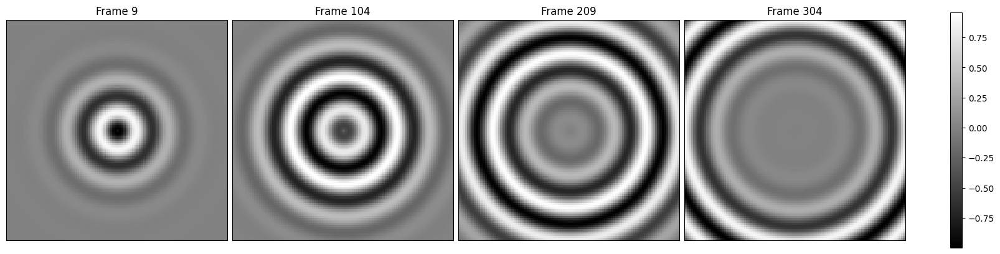

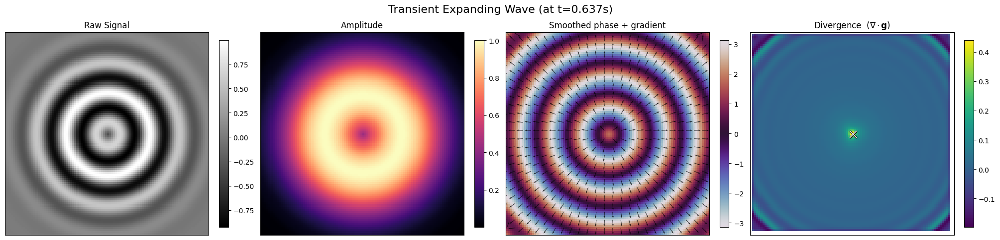

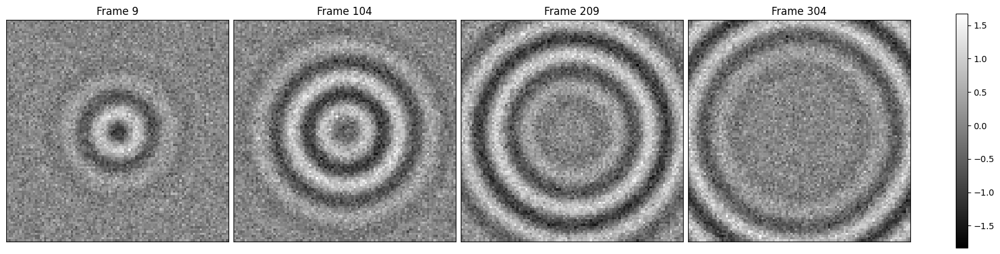

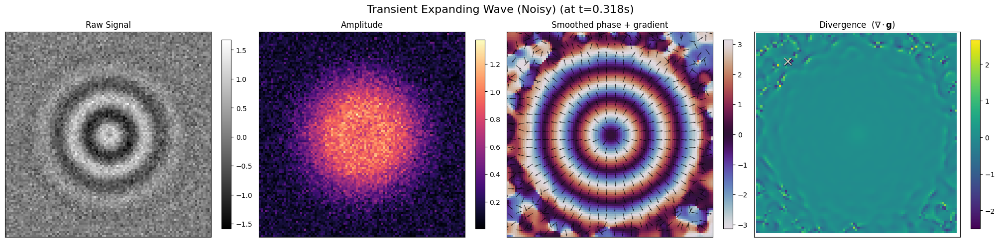

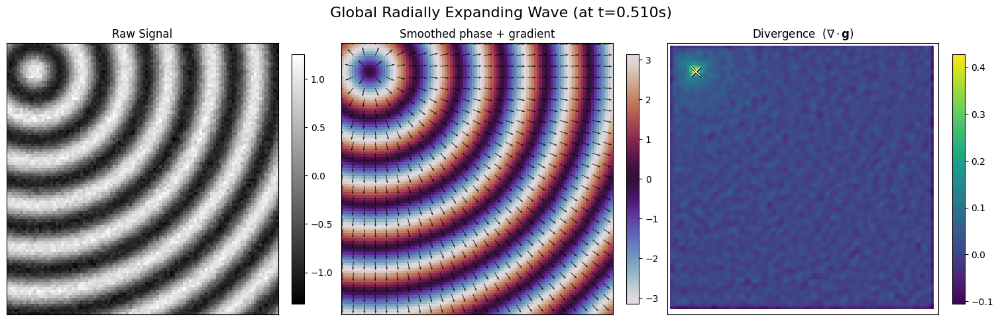

...

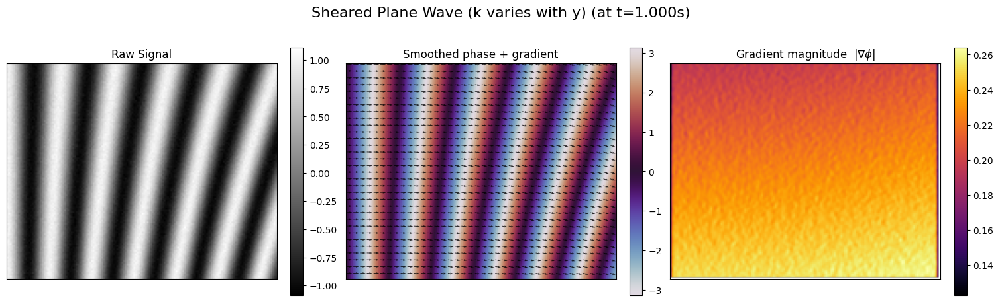

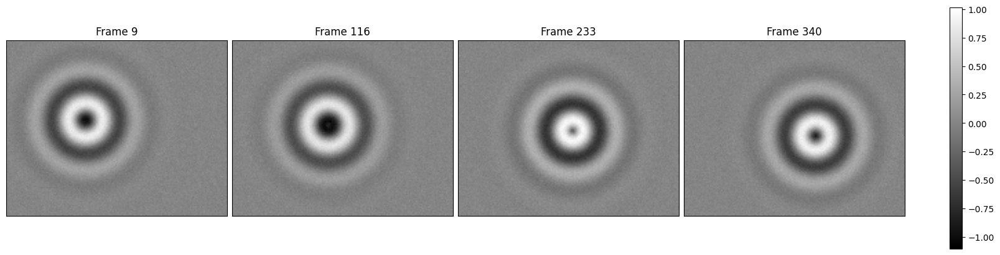

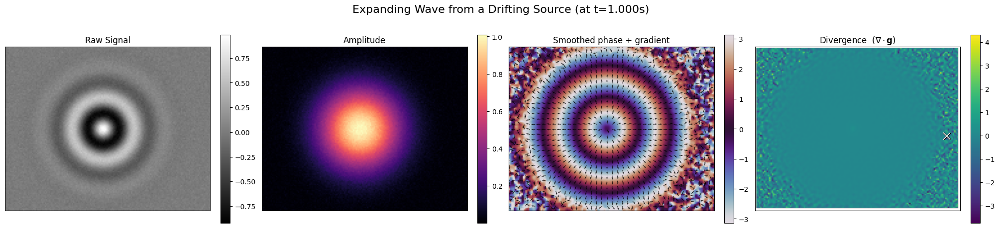

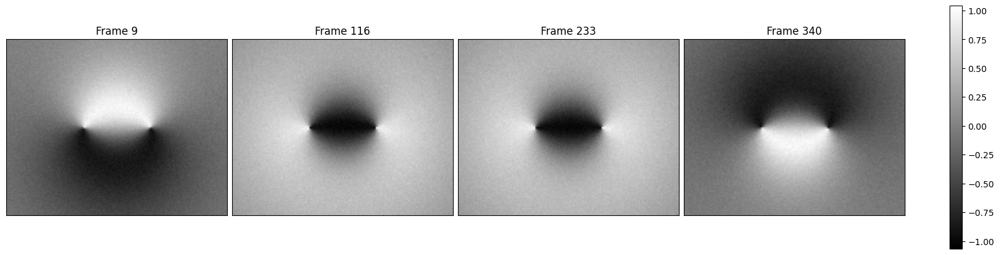

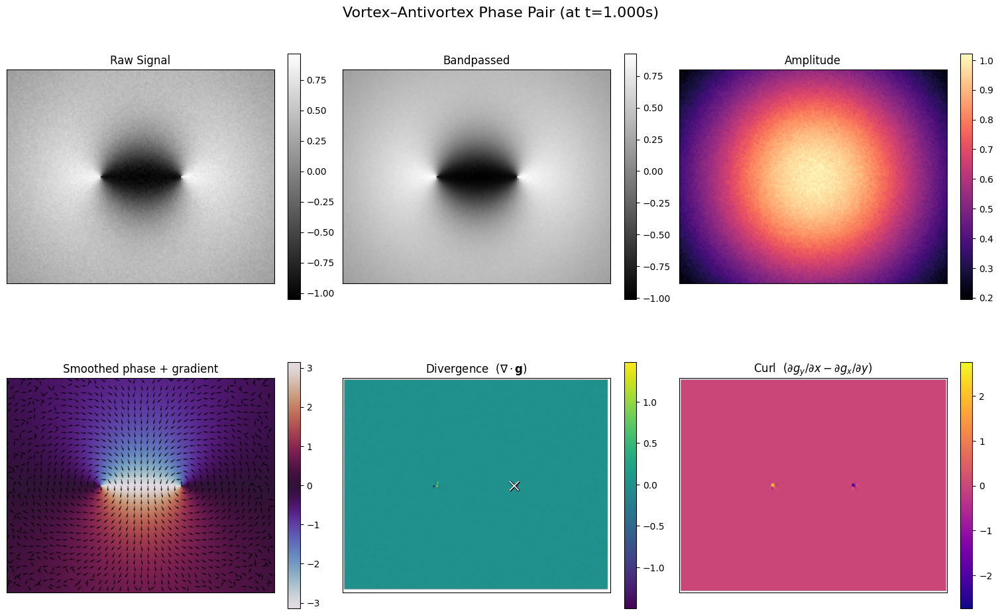

In [7]:
Fs = 157.0
# Plot options: 'raw_signal', 'bandpassed_signal', 'amplitude', 'phase', 'gradient_vectors', 'gradient_magnitude', 'divergence', 'curl'

movie_expanding = make_expanding_shell()
plot_four_frames(movie_expanding)
results = analyze_phase(movie_expanding, Fs, lo=4, hi=20, sigma_px=1.0, identify_source=True)
plot = plot_phase_results(movie_expanding, results, frame=100, plots=['raw_signal', 'amplitude', 'gradient_vectors', 'divergence'], identify_source=True, title='Transient Expanding Wave')

movie_expanding = make_expanding_shell(noise_std=0.25)
plot_four_frames(movie_expanding)
results = analyze_phase(movie_expanding, Fs, lo=4, hi=20, sigma_px=2.0, identify_source=True)
plot = plot_phase_results(movie_expanding, results, frame=50, plots=['raw_signal', 'amplitude', 'gradient_vectors', 'divergence'], identify_source=True, title='Transient Expanding Wave (Noisy)')

# Radial wave near the corner
movie_radial = make_radial_wave(source=(10, 10))
res_radial = analyze_phase(movie_radial, Fs, lo=4, hi=20, sigma_px=1.0, identify_source=True)
plot = plot_phase_results(movie_radial, res_radial, frame=80, plots=['raw_signal', 'gradient_vectors', 'divergence'], identify_source=True, title='Global Radially Expanding Wave')

# Plane wave
movie_plane = make_plane_wave(angle_deg=0, noise_std=0)
res_plane = analyze_phase(movie_plane, Fs, lo=4, hi=20, sigma_px=1.0)
plot = plot_phase_results(movie_plane, res_plane, frame=80, plots=['raw_signal', 'amplitude', 'gradient_vectors', 'divergence'], title='Plane Wave')

# Spiral wave
movie_spiral = make_rotating_wave()
res_spiral = analyze_phase(movie_spiral, Fs, lo=4, hi=20, sigma_px=1.0, identify_source=True)
plot = plot_phase_results(movie_spiral, res_spiral, frame=80, plots=['raw_signal', 'gradient_vectors', 'divergence', 'curl'], identify_source=True, title='Spiral Wave')

# Rotating Wave
movie_rot = make_rotating_pure()
res_rot = analyze_phase(movie_rot, Fs, lo=4, hi=20, sigma_px=1.2)
plot = plot_phase_results(movie_rot, res_rot, frame=80, plots=['raw_signal', 'gradient_vectors', 'divergence', 'curl'], identify_source=True, title='Rotating Wave')

# ---------------------------
# Common setup
# ---------------------------
Fs = 175.0
duration = 2.0
nt = int(Fs * duration)

ny, nx = 128, 160
y = np.arange(ny)[:, None]      # (ny, 1)
x = np.arange(nx)[None, :]      # (1, nx)
Y, X = np.meshgrid(np.arange(ny), np.arange(nx), indexing='ij')

# time axis shaped (1,1,nt) for broadcasting
t = (np.arange(nt)[None, None, :]) / Fs

# convenience: list of all plot panels your plotter supports
plots_all = [
    'raw_signal', 'bandpassed_signal', 'amplitude', 'phase',
    'gradient_vectors', 'gradient_magnitude', 'divergence', 'curl'
]

rng = np.random.default_rng(42)

# =========================================================
# 3) Traveling AM plane-wave packet (localized envelope moves on a carrier)
#    Shows clear phase gradients + localized amplitude support
# =========================================================
angle_deg = 30.0
theta = np.deg2rad(angle_deg)
vx, vy = np.cos(theta), np.sin(theta)  # direction of travel

lam = 28.0
k = 2*np.pi/lam
f_car = 10.0  # carrier in-band
speed_px_per_s = 40.0  # spatial shift per second of the envelope
sigma_env = 18.0

movie_packet = np.zeros((ny, nx, nt), dtype=float)
x0, y0 = nx*0.2, ny*0.5
for i in range(nt):
    # envelope center moves
    xc = x0 + speed_px_per_s * (i/Fs) * vx
    yc = y0 + speed_px_per_s * (i/Fs) * vy
    env = np.exp(-((X - xc)**2 + (Y - yc)**2) / (2*sigma_env**2))
    phase = k*(X*np.cos(theta) + Y*np.sin(theta)) - 2*np.pi*f_car*(i/Fs)
    movie_packet[:, :, i] = env * np.cos(phase)
movie_packet += 0.03 * rng.standard_normal((ny, nx, nt))

plot_four_frames(movie_packet, title='Travelling Wave Packet')
res_packet = analyze_phase(movie_packet, Fs, lo=4, hi=20, sigma_px=0.0, identify_source=True)
plot_phase_results(
    movie_packet, res_packet, frame=nt//2,
    identify_source=True, title='Traveling AM Plane-Wave Packet',
    plots = ['raw_signal', 'bandpassed_signal', 'amplitude', 'gradient_vectors'])

# ---------------------------------------------------------
# G) Sheared plane wave (wavevector varies slowly with y)
#    φ(x,y,t) = k(y)·x − ωt; ∇φ changes across y; curl(∇φ)=0 ideally (up to numerics)
# ---------------------------------------------------------
k0 = 2*np.pi/28.0
alpha = 0.002  # shear of spatial frequency with y
f0 = 9.0
movie_shear = np.zeros((ny, nx, nt))
for i in range(nt):
    ky = k0*(1 + alpha*(Y - ny/2))
    phase = ky*X - 2*np.pi*f0*(i/Fs)
    movie_shear[..., i] = np.cos(phase)
movie_shear += 0.03 * rng.standard_normal((ny, nx, nt))

res_shear = analyze_phase(movie_shear, Fs, lo=4, hi=20, sigma_px=1.0, identify_source=True)
plot_phase_results(movie_shear, res_shear, frame=nt//2, 
                   identify_source=True, title='Sheared Plane Wave (k varies with y)',
                plots = ['raw_signal', 'gradient_vectors', 'gradient_magnitude'])

# ---------------------------------------------------------
# I) Accelerating radial source (source drifts while phase fronts expand)
#    Source (x_s(t), y_s(t)) moves; divergence ridge follows it
# ---------------------------------------------------------
f0 = 10.0
movie_drifting_src = np.zeros((ny, nx, nt))
speed = 20.0  # px/s
for i in range(nt):
    xs = nx*0.35 + speed*(i/Fs)  # drift to the right
    ys = ny*0.45 + 0.3*speed*(i/Fs)  # slight upward drift
    Rmov = np.sqrt((X - xs)**2 + (Y - ys)**2)
    phase = (2*np.pi/25.0)*Rmov - 2*np.pi*f0*(i/Fs)
    env = np.exp(-(Rmov**2)/(2*22.0**2))
    movie_drifting_src[..., i] = env * np.cos(phase)
movie_drifting_src += 0.03 * rng.standard_normal((ny, nx, nt))

plot_four_frames(movie_drifting_src)
res_drift = analyze_phase(movie_drifting_src, Fs, lo=4, hi=20, sigma_px=1.0, identify_source=True)
plot_phase_results(movie_drifting_src, res_drift, frame=nt//2, 
                   identify_source=True, title='Expanding Wave from a Drifting Source',
                plots = ['raw_signal', 'amplitude', 'gradient_vectors','divergence'])

# ---------------------------------------------------------
# E) Vortex–antivortex phase pair (topological singularities)
#    Build phase field via atan2; modulate in time to spin; strong ±curl cores
# ---------------------------------------------------------
x0, y0 = nx*0.35, ny*0.5
x1, y1 = nx*0.65, ny*0.5
phi0 = np.arctan2(Y - y0, X - x0)       # vortex
phi1 = -np.arctan2(Y - y1, X - x1)      # anti-vortex
phi_pair = np.angle(np.exp(1j*(phi0 + phi1)))  # wrap to (-π,π]
fspin = 6.0
env = np.exp(-((X-nx/2)**2 + (Y-ny/2)**2)/(2*(0.45*min(nx,ny))**2))
movie_vpair = np.zeros((ny, nx, nt))
for i in range(nt):
    movie_vpair[..., i] = env * np.cos(phi_pair - 2*np.pi*fspin*(i/Fs))
movie_vpair += 0.03 * rng.standard_normal((ny, nx, nt))

plot_four_frames(movie_vpair)
res_vpair = analyze_phase(movie_vpair, Fs, lo=4, hi=20, sigma_px=1.0, identify_source=True)
plot_phase_results(movie_vpair, res_vpair, frame=nt//2,
                   identify_source=True, title='Vortex–Antivortex Phase Pair',
                plots = ['raw_signal', 'bandpassed_signal', 'amplitude', 'gradient_vectors', 'divergence', 'curl'])

## Interfering Travelling Waves

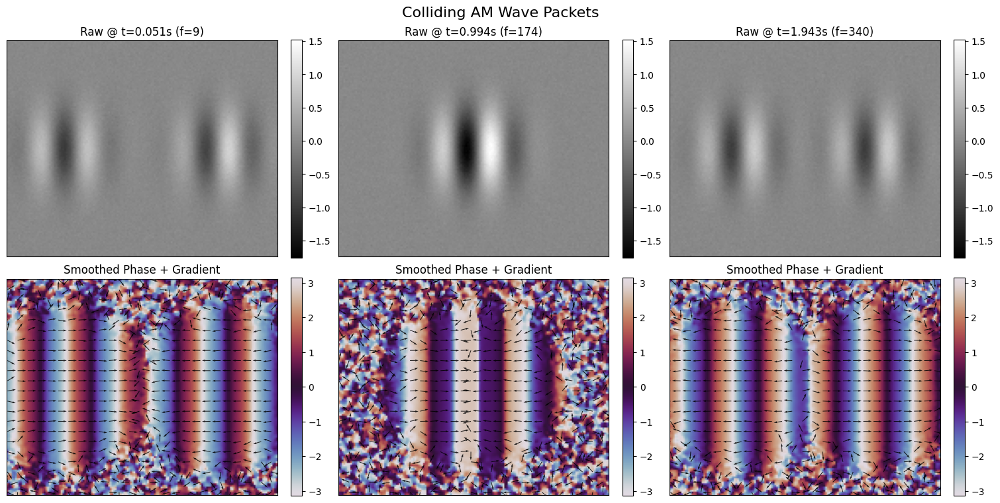

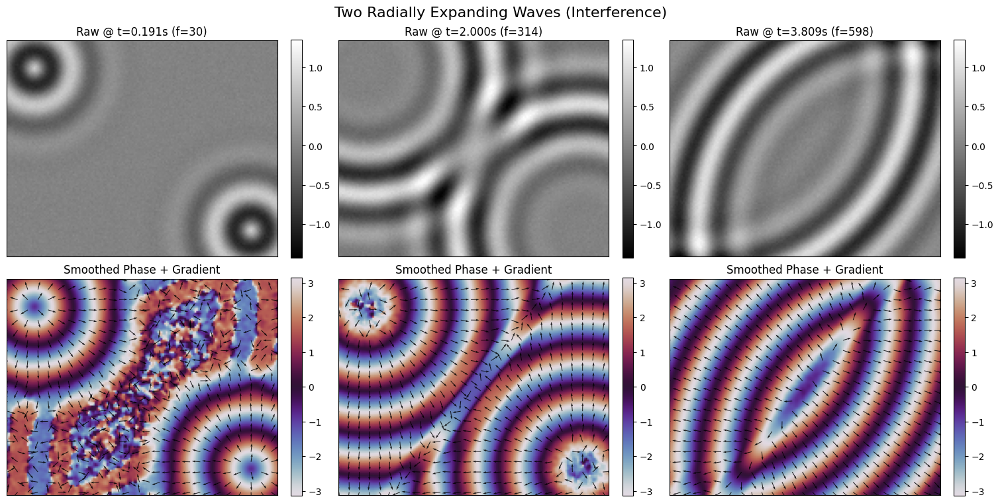

In [5]:
rng = np.random.default_rng(7)
plots_all = [
    'raw_signal', 'bandpassed_signal', 'amplitude', 'phase',
    'gradient_vectors', 'gradient_magnitude', 'divergence', 'curl'
]

# =========================================================
# Colliding AM wave packets (two localized carriers passing through)
# =========================================================
duration = 2
nt = int(Fs * duration)
ny, nx = 128, 160
y = np.arange(ny)[:, None]
x = np.arange(nx)[None, :]
Y, X = np.meshgrid(np.arange(ny), np.arange(nx), indexing='ij')
t = (np.arange(nt)[None, None, :]) / Fs

lam = 30.0; k = 2*np.pi/lam; f0 = 12.0
sigma_env = 16.0; speed = 45.0
movie_collision = np.zeros((ny, nx, nt))
xL0, xR0 = nx*0.20, nx*0.80
for i in range(nt):
    xcL = xL0 + speed*(i/Fs)      # left packet moves right
    xcR = xR0 - speed*(i/Fs)      # right packet moves left
    envL = np.exp(-((X - xcL)**2 + (Y - ny*0.5)**2)/(2*sigma_env**2))
    envR = np.exp(-((X - xcR)**2 + (Y - ny*0.5)**2)/(2*sigma_env**2))
    phL = k*X - 2*np.pi*f0*(i/Fs)
    phR = -k*X - 2*np.pi*f0*(i/Fs)
    movie_collision[..., i] = envL*np.cos(phL) + envR*np.cos(phR)
movie_collision += 0.03 * rng.standard_normal((ny, nx, nt))

res_collision = analyze_phase(movie_collision, Fs, lo=4, hi=20, sigma_px=1.0, identify_source=True)
plot_frames_with_phase_quiver(
    movie_collision, res_collision, frames=None, title='Colliding AM Wave Packets',
    quiver_scale=0.2, quiver_step=6)


# =========================================================
# Two interfering radial waves
# =========================================================

# Common settings
Fs = 157.0
duration = 4.0
nt = int(Fs * duration)

ny, nx = 128, 160
y = np.arange(ny)[:, None]
x = np.arange(nx)[None, :]
Y, X = np.meshgrid(np.arange(ny), np.arange(nx), indexing='ij')
t = (np.arange(nt)[None, None, :]) / Fs

# Parameters
f0 = 10.0                # Hz (inside 4–20 band)
lam = 25.0               # spatial wavelength (px)
k = 2*np.pi/lam
v = 35.0                 # ring expansion speed (px/s)
sigma_r = 20.0           # ring thickness (px)

# Sources near opposite corners
xA, yA = 16.0, 16.0
xB, yB = nx - 16.0, ny - 16.0
R_A = np.sqrt((X - xA)**2 + (Y - yA)**2)
R_B = np.sqrt((X - xB)**2 + (Y - yB)**2)

movie_radial_duo = np.zeros((ny, nx, nt), dtype=float)
for i in range(nt):
    tau = i / Fs
    r0 = v * tau
    envA = np.exp(-((R_A - r0)**2) / (2*sigma_r**2))
    envB = np.exp(-((R_B - r0)**2) / (2*sigma_r**2))
    phA = k*R_A - 2*np.pi*f0*tau
    phB = k*R_B - 2*np.pi*f0*tau
    frame = envA*np.cos(phA) + envB*np.cos(phB)
    movie_radial_duo[..., i] = frame

# light noise
movie_radial_duo += 0.03 * rng.standard_normal((ny, nx, nt))
res_radial_duo = analyze_phase(movie_radial_duo, Fs, lo=4, hi=20, sigma_px=1.0, identify_source=True)
plot_frames_with_phase_quiver(
    movie_radial_duo, res_radial_duo, frames=[30, nt//2, nt-30], title='Two Radially Expanding Waves (Interference)',
    quiver_scale=0.2, quiver_step=6)

## Non-Travelling Wave Control Tests

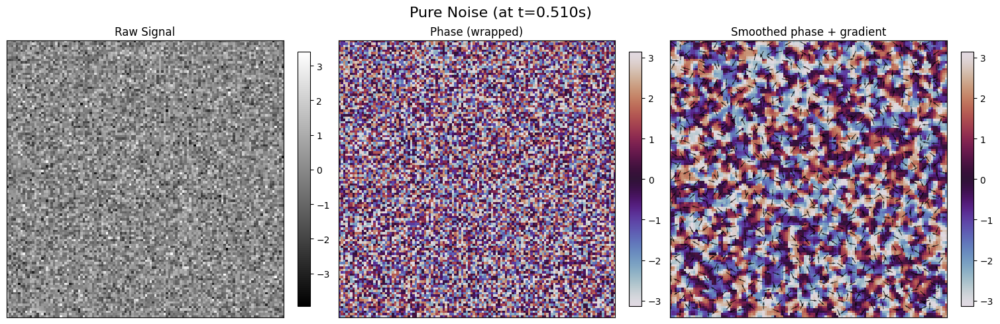

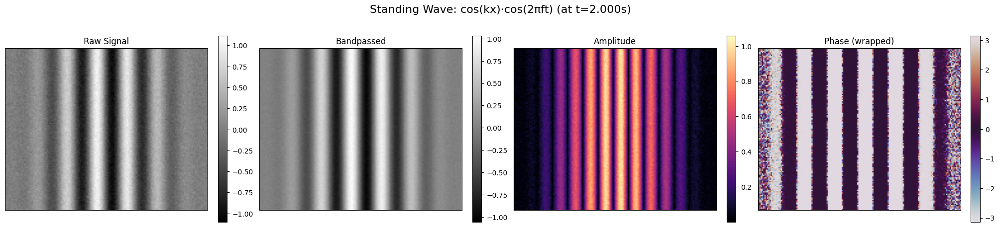

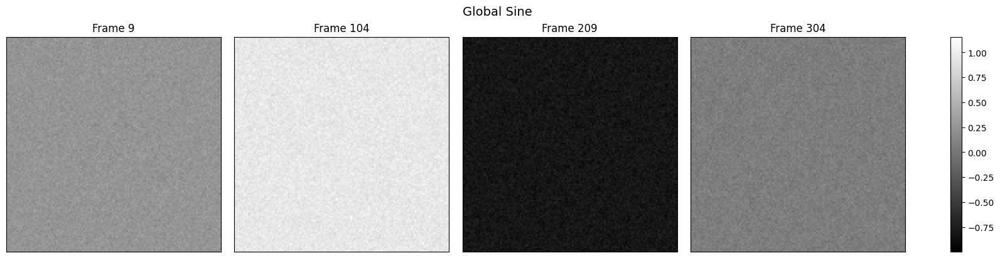

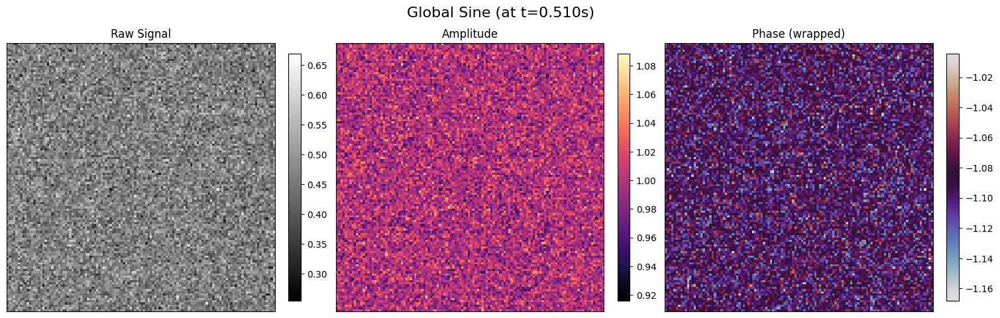

In [6]:
# Pure noise
movie_noise = make_pure_noise()
res_noise = analyze_phase(movie_noise, Fs, lo=4, hi=20, sigma_px=1.0)
plot_phase_results(movie_noise, res_noise, frame=80, title='Pure Noise',
                   plots=['raw_signal', 'phase', 'gradient_vectors'])

# =========================================================
# 1) Standing wave (1D along x): cos(kx) * cos(2π f t)
#    Node/antinode structure fixed in space (classic standing wave)
# =========================================================
lam_px = 24.0
k = 2*np.pi / lam_px
f0 = 8.0  # Hz, in-band (e.g., 4–20)
window = np.hanning(nx)[None, :]  # soft edges to avoid wrap artifacts
movie_standing = (np.cos(k * X) * window)[:, :, None] * np.cos(2*np.pi*f0 * t)
movie_standing += 0.05 * rng.standard_normal((ny, nx, nt))  # small noise

#plot_four_frames(movie_standing, title='Standing Wave')
res_stand = analyze_phase(movie_standing, Fs, lo=4, hi=20, sigma_px=1.0, identify_source=True)
plot_phase_results(
    movie_standing, res_stand, frame=nt//2,
    identify_source=True, title='Standing Wave: cos(kx)·cos(2πft)',
    plots = ['raw_signal', 'bandpassed_signal', 'amplitude', 'phase'])

# Global sine
movie_global_sine = make_global_sine()
plot_four_frames(movie_global_sine, title='Global Sine')
res_global_sine = analyze_phase(movie_global_sine, Fs, lo=4, hi=20, sigma_px=1.0)
plot_phase_results(movie_global_sine, res_global_sine, frame=80, title='Global Sine', 
                   plots=['raw_signal', 'amplitude', 'phase'])

## What is up with bandpassing??

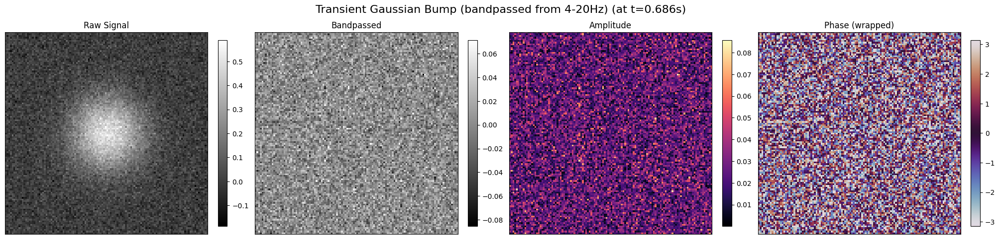

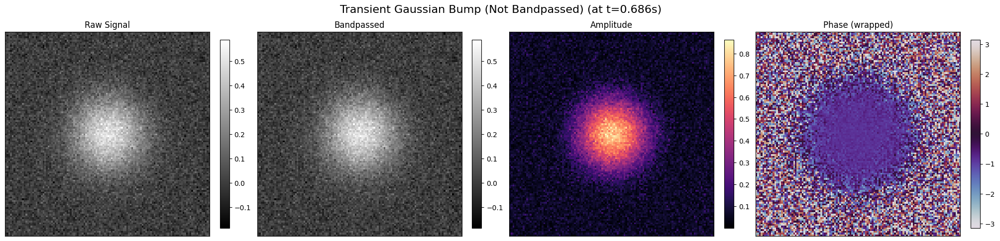

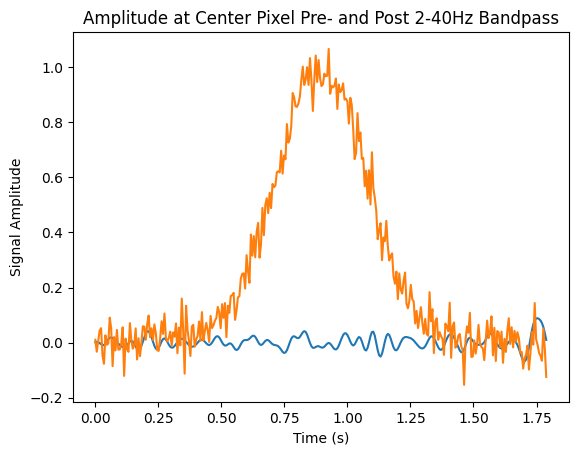

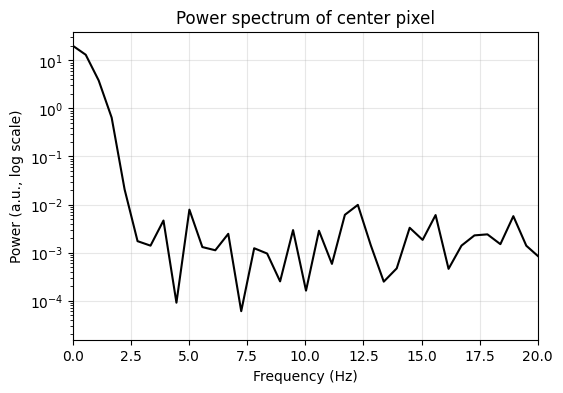

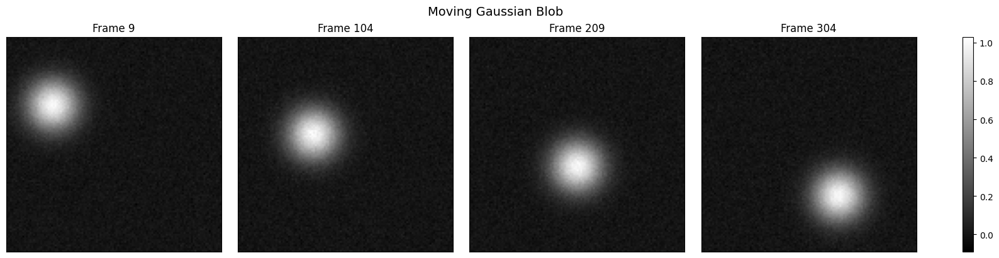

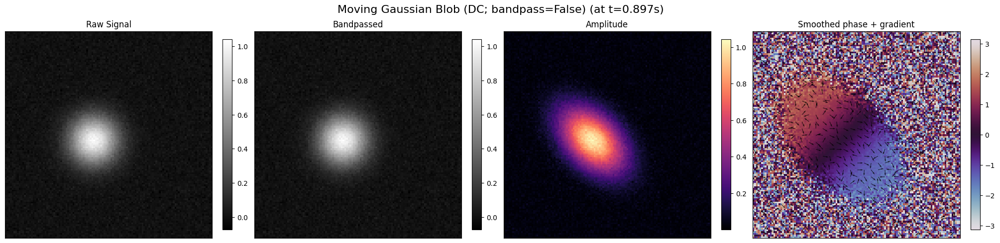

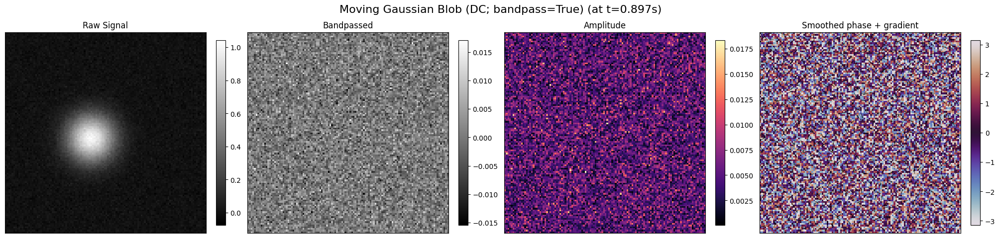

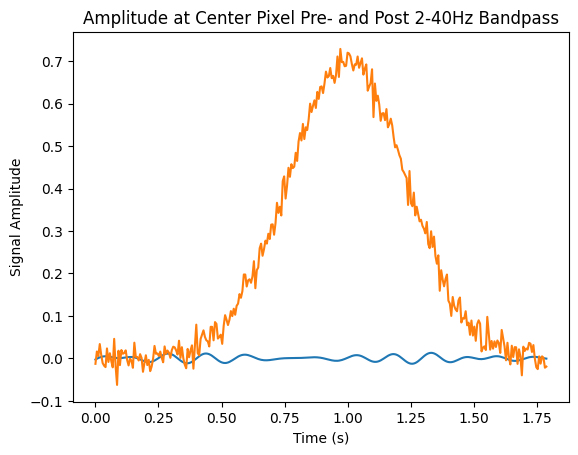

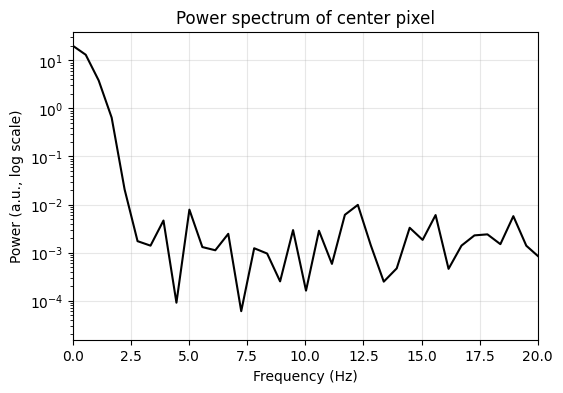

In [24]:
# ---------------------------
# Common setup
# ---------------------------
Fs = 175.0
duration = 2.0
nt = int(Fs * duration)

ny, nx = 120, 120
y = np.arange(ny)[:, None]      # (ny, 1)
x = np.arange(nx)[None, :]      # (1, nx)
Y, X = np.meshgrid(np.arange(ny), np.arange(nx), indexing='ij')

# time axis shaped (1,1,nt) for broadcasting
t = (np.arange(nt)[None, None, :]) / Fs

# convenience: list of all plot panels your plotter supports
plots_all = [
    'raw_signal', 'bandpassed_signal', 'amplitude', 'phase',
    'gradient_vectors', 'gradient_magnitude', 'divergence', 'curl'
]

rng = np.random.default_rng(42)

# =========================================================
# Transient gaussian bump
# =========================================================
movie_bump = make_transient_bump()
res_bump_bp = analyze_phase(movie_bump, Fs, lo=4, hi=20, sigma_px=1.0)
plot_phase_results(movie_bump, res_bump_bp, frame=120, title='Transient Gaussian Bump (bandpassed from 4-20Hz)', 
                   plots=['raw_signal', 'bandpassed_signal', 'amplitude', 'phase'])
res_bump = analyze_phase(movie_bump, Fs, lo=4, hi=20, sigma_px=1.0, bandpass=False)
plot_phase_results(movie_bump, res_bump, frame=120, title='Transient Gaussian Bump (Not Bandpassed)', 
                   plots=['raw_signal', 'bandpassed_signal', 'amplitude', 'phase'])

plt.plot(res_bump_bp['t'], res_bump_bp['movie_bp'][60,60,:], label='Bandpassed')
plt.plot(res_bump_bp['t'], movie_bump[60,60,:], label='Not Bandpassed')
plt.xlabel('Time (s)')
plt.ylabel('Signal Amplitude')
plt.title('Amplitude at Center Pixel Pre- and Post 2-40Hz Bandpass')
plt.show()

ny, nx, nt = movie_bump.shape
center_trace = movie_bump[ny//2, nx//2, :]   # time series at center pixel

# Compute Fourier spectrum
freqs = np.fft.rfftfreq(nt, d=1/Fs)
spectrum = np.fft.rfft(center_trace)
power = np.abs(spectrum)**2 / nt        # power spectrum (normalized by length)

# Plot
plt.figure(figsize=(6,4))
plt.semilogy(freqs, power, color='k')
plt.xlabel("Frequency (Hz)")
plt.ylabel("Power (a.u., log scale)")
plt.title("Power spectrum of center pixel")
plt.xlim(0, 20)
plt.grid(True, alpha=0.3)
plt.show()

# =========================================================
# 4) Moving Gaussian blob (no carrier) — pure translation of a DC blob
#    Useful for seeing effect of bandpass removal vs. bandpass=False
# =========================================================
sigma_blob = 10.0
speed = 30.0  # px/s diagonal
movie_blob_dc = np.zeros((ny, nx, nt), dtype=float)
x0, y0 = nx*0.2, ny*0.3
for i in range(nt):
    xc = x0 + speed*(i/Fs)
    yc = y0 + speed*(i/Fs)
    movie_blob_dc[:, :, i] = np.exp(-((X - xc)**2 + (Y - yc)**2) / (2*sigma_blob**2))
movie_blob_dc += 0.02 * rng.standard_normal((ny, nx, nt))

plot_four_frames(movie_blob_dc, title='Moving Gaussian Blob')
res_blob_dc = analyze_phase(movie_blob_dc, Fs, bandpass=False, sigma_px=0.0, identify_source=True)
plot_phase_results(
    movie_blob_dc, res_blob_dc, frame=nt//2,
    identify_source=True, title='Moving Gaussian Blob (DC; bandpass=False)',
    plots = ['raw_signal', 'bandpassed_signal', 'amplitude', 'gradient_vectors'])
res_blob_dc = analyze_phase(movie_blob_dc, Fs, bandpass=True, sigma_px=0.0, identify_source=True)
plot_phase_results(
    movie_blob_dc, res_blob_dc, frame=nt//2,
    identify_source=True, title='Moving Gaussian Blob (DC; bandpass=True)',
    plots = ['raw_signal', 'bandpassed_signal', 'amplitude', 'gradient_vectors'])

plt.plot(res_blob_dc['t'], res_blob_dc['movie_bp'][60,60,:], label='Bandpassed')
plt.plot(res_blob_dc['t'], movie_blob_dc[60,60,:], label='Not Bandpassed')
plt.xlabel('Time (s)')
plt.ylabel('Signal Amplitude')
plt.title('Amplitude at Center Pixel Pre- and Post 2-40Hz Bandpass')

# Plot
plt.figure(figsize=(6,4))
plt.semilogy(freqs, power, color='k')
plt.xlabel("Frequency (Hz)")
plt.ylabel("Power (a.u., log scale)")
plt.title("Power spectrum of center pixel")
plt.xlim(0, 20)
plt.grid(True, alpha=0.3)
plt.show()

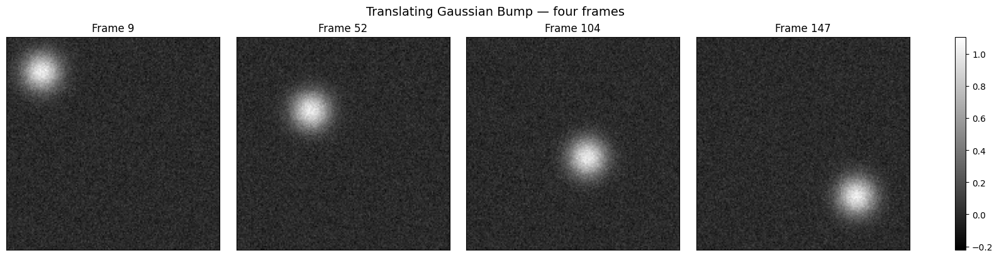

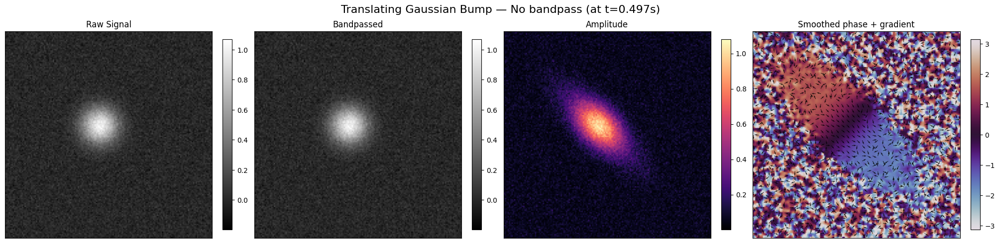

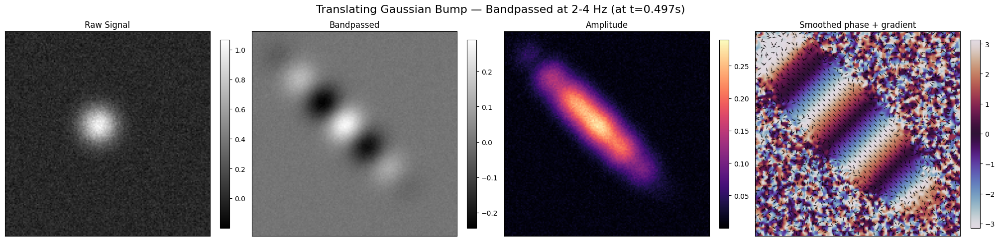

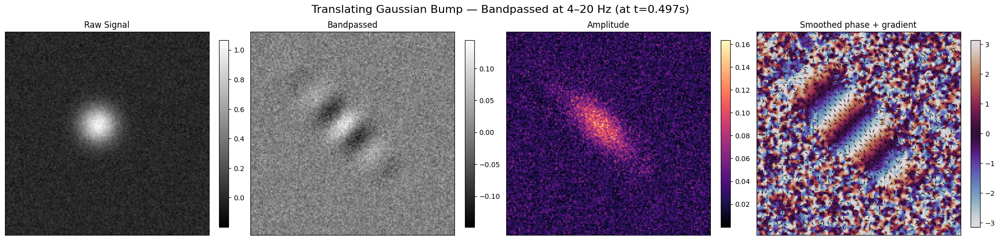

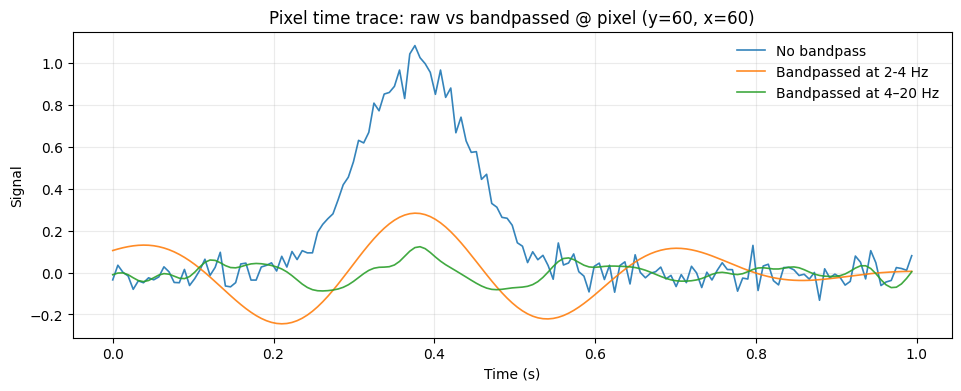

...

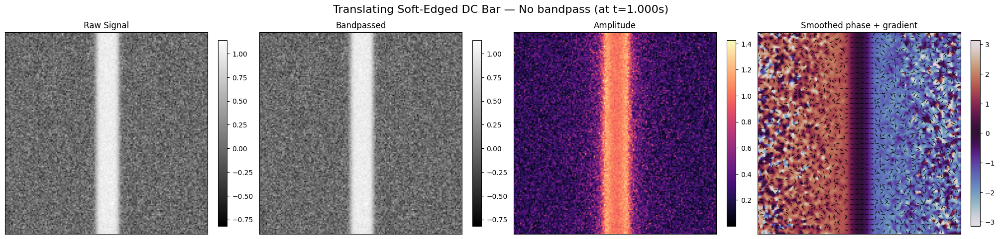

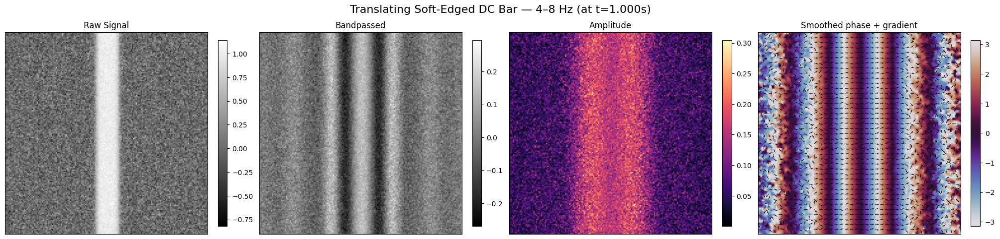

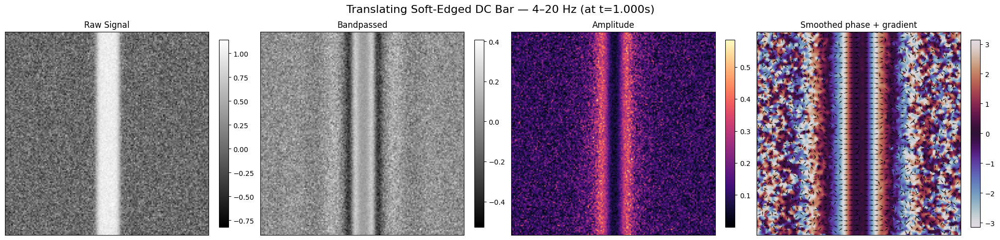

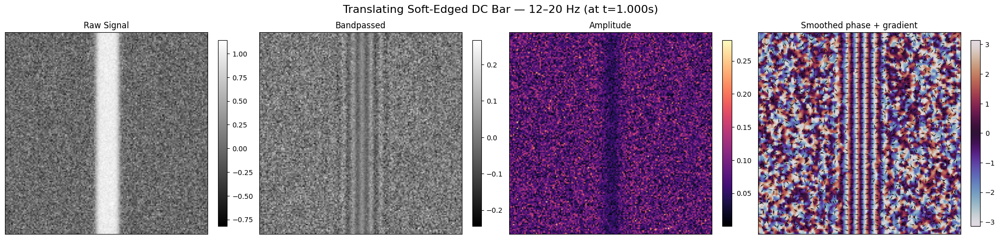

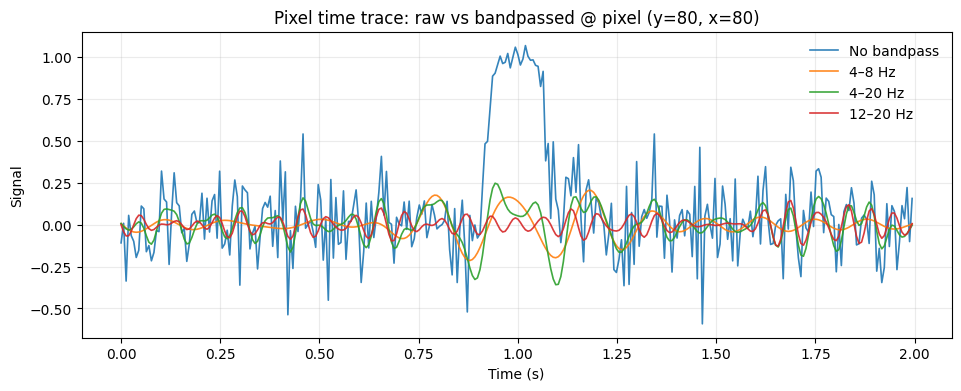

In [19]:
def run_and_plot_bands(
    movie, title_prefix,
    frame=None, bands=None, sigma_px=1.0,
    pixel=None,                 # (iy, ix); default: image center
    trace_title='Pixel time trace: raw vs bandpassed',
    plots=('raw_signal','bandpassed_signal','amplitude','gradient_vectors')  # spatial panels
):
    """
    For one movie:
      1) Preview four frames
      2) Plot a SINGLE figure with the raw trace + all bandpassed traces at one pixel
      3) For each band, show the requested spatial panels

    bands: list of dicts like:
      {'bandpass': False, 'label': 'No bandpass'}
      {'lo': 4, 'hi': 20, 'label': '4–20 Hz'}
      {'lo': 9, 'hi': 11, 'label': '9–11 Hz'}
    """
    ny, nx, nt = movie.shape
    if bands is None:
        bands = [
            {'bandpass': False, 'label': 'No bandpass'},
            {'lo': 4, 'hi': 20, 'label': '4–20 Hz'},
            {'lo': 8, 'hi': 14, 'label': '8–14 Hz'},
        ]
    if frame is None:
        frame = nt // 2
    if pixel is None:
        iy, ix = ny // 2, nx // 2
    else:
        iy = int(np.clip(pixel[0], 0, ny-1))
        ix = int(np.clip(pixel[1], 0, nx-1))

    # quick preview of evolution
    plot_four_frames(movie, title=f'{title_prefix} — four frames')

    # collect traces first (so we can plot them together in one figure)
    # correct time axis
    t = np.arange(nt) / Fs
    raw_trace = movie[iy, ix, :]

    traces = []   # list of (label, bp_trace)
    results_cache = []  # keep results to avoid recompute for spatial plots

    for cfg in bands:
        if cfg.get('bandpass', True) is False:
            res = analyze_phase(movie, Fs, bandpass=False, sigma_px=sigma_px, identify_source=True)
            label = cfg.get('label', 'No bandpass')
        else:
            res = analyze_phase(movie, Fs, lo=cfg['lo'], hi=cfg['hi'], sigma_px=sigma_px, identify_source=True)
            label = cfg.get('label', f"{cfg['lo']}–{cfg['hi']} Hz")

        bp_trace = res['movie_bp'][iy, ix, :]
        traces.append((label, bp_trace))
        results_cache.append((label, res))

    # spatial panels per band
    for label, res in results_cache:
        plot_phase_results(
            movie, res, frame=frame, plots=list(plots),
            identify_source=True, title=f'{title_prefix} — {label}'
        )

    # ONE figure with all traces (raw + each band)
    fig, ax = plt.subplots(1, 1, figsize=(9.5, 3.8), constrained_layout=True)
    for label, tr in traces:
        ax.plot(t, tr, lw=1.2, alpha=0.9, label={label})
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Signal')
    ax.set_title(f'{trace_title} @ pixel (y={iy}, x={ix})')
    ax.legend(loc='upper right', ncols=1, frameon=False)
    ax.grid(True, alpha=0.25)
    plt.show()

# =========================================================
# Translating gaussian bump (relatively wide and slow)
# =========================================================

# Parameters
Fs = 157.0
duration = 1.0            # seconds
nt = int(Fs * duration)   # number of frames
ny, nx = 160, 160

# Spatial grid
Y, X = np.meshgrid(np.arange(ny), np.arange(nx), indexing='ij')

# Time axis
t = np.arange(nt) / Fs

# Blob parameters
sigma_blob = 10.0        # larger sigma than before
speed = 150.0            # px/s (slower to make oscillations clearer)
x0, y0 = 20, 20          # starting point

rng = np.random.default_rng(0)
movie = 0.05 * rng.standard_normal((ny, nx, nt))  # noisy background

# Generate translating Gaussian blob
for i in range(nt):
    tau = t[i]
    xc = x0 + speed * tau * (1/np.sqrt(2))
    yc = y0 + speed * tau * (1/np.sqrt(2))
    blob = np.exp(-((X - xc)**2 + (Y - yc)**2) / (2 * sigma_blob**2))
    movie[..., i] += blob

run_and_plot_bands(
    movie,
    'Translating Gaussian Bump',
    bands=[
        {'bandpass': False, 'label': 'No bandpass'},
        {'lo': 2,  'hi': 4, 'label': 'Bandpassed at 2-4 Hz'},
        {'lo': 4,  'hi': 20, 'label': 'Bandpassed at 4–20 Hz'}
    ],
    pixel=(60, 60)
)
# =========================================================
# Translating gaussian bump (fast and narrow)
# =========================================================

Fs = 157.0
duration = 0.5
nt = int(Fs * duration)

ny, nx = 160, 160
Y, X = np.meshgrid(np.arange(ny), np.arange(nx), indexing='ij')
t = (np.arange(nt)[None, None, :]) / Fs
sigma_blob = 4.0          # narrower -> more high-f content
speed = 300.0             # px/s -> f_char ~ speed/(2πσ) ≈ 15.9 Hz (in 4–20 Hz band)
x0, y0 = nx*0.25, ny*0.25

movie_blob_fast = 0.10 * rng.standard_normal((ny, nx, nt))
for i in range(nt):
    tau = i / Fs
    xc = x0 + speed * tau * (1/np.sqrt(2))
    yc = y0 + speed * tau * (1/np.sqrt(2))
    blob = np.exp(-((X - xc)**2 + (Y - yc)**2) / (2 * sigma_blob**2))
    movie_blob_fast[..., i] += blob

run_and_plot_bands(
    movie_blob_fast,
    'Translating Fast Narrow Gaussian Bump',
    bands=[
        {'bandpass': False, 'label': 'No bandpass'},
        {'lo': 4,  'hi': 20, 'label': '4–20 Hz'},
        {'lo': 10, 'hi': 14, 'label': '10–14 Hz'},
        {'lo': 6,  'hi': 8,  'label': '6–8 Hz'},
    ],
    pixel=(60, 60)
)

# =========================================================
# Non-oscillating bar with noisy background and soft edges
# =========================================================
Fs = 157.0
duration = 2.0
nt = int(Fs * duration)

ny, nx = 160, 160
Y, X = np.meshgrid(np.arange(ny), np.arange(nx), indexing='ij')
t = (np.arange(nt)[None, None, :]) / Fs

rng = np.random.default_rng(2025)

bar_width = 18   # px
edge_sigma = 2.0 # controls softness of fade at edges

# noisy background
movie_bar = 0.2 * rng.standard_normal((ny, nx, nt))

x0, x1 = -40, nx + 40
for i in range(nt):
    # bar center position
    x_center = np.interp(i, [0, nt-1], [x0, x1])
    # distance from bar center
    dist = X - x_center
    # smooth mask: ~1 inside bar, ~0 outside, with soft transition at edges
    mask = 0.5 * (np.tanh((bar_width/2 - dist)/edge_sigma) +
                  np.tanh((bar_width/2 + dist)/edge_sigma))
    mask = mask / mask.max()  # normalize to 0–1

    # textured bar intensity
    tex = 1.0 + 0.05 * rng.standard_normal((ny, nx))
    # apply bar on top of background
    movie_bar[..., i] = (1 - mask) * movie_bar[..., i] + mask * tex

run_and_plot_bands(
    movie_bar, 'Translating Soft-Edged DC Bar',
    bands=[
        {'bandpass': False, 'label': 'No bandpass'},
        {'lo': 4, 'hi': 8, 'label': '4–8 Hz'},
        {'lo': 4, 'hi': 20, 'label': '4–20 Hz'},
        {'lo': 12, 'hi': 20, 'label': '12–20 Hz'},
    ]
)

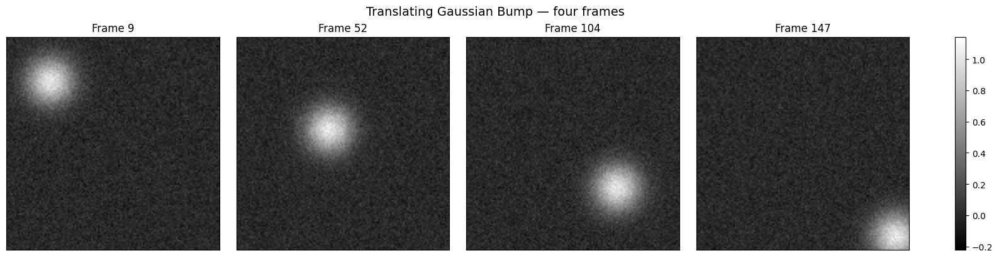

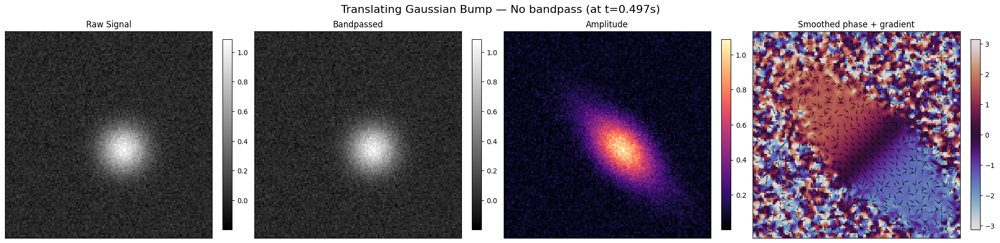

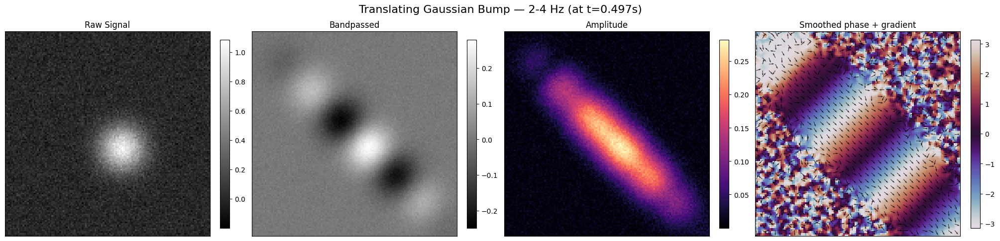

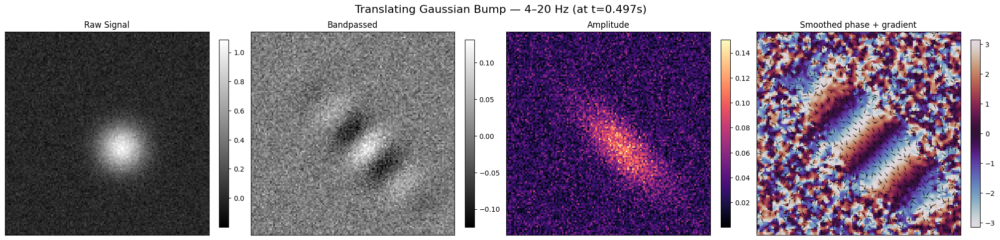

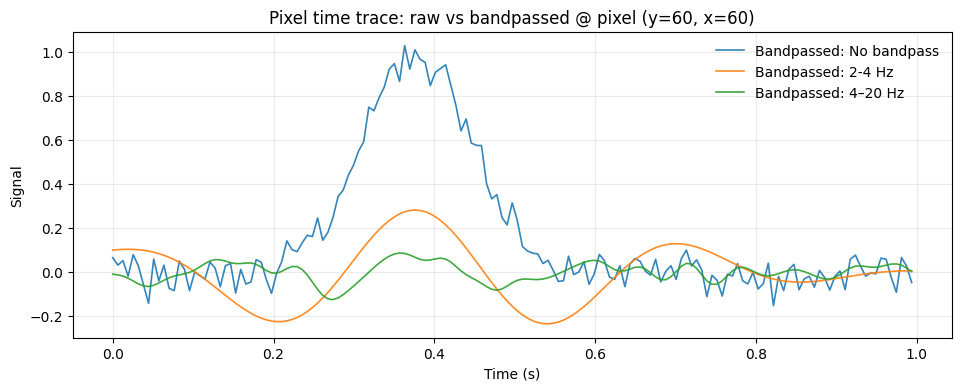

In [16]:
# Parameters
Fs = 157.0
duration = 1.0            # seconds
nt = int(Fs * duration)   # number of frames
ny, nx = 128, 128

# Spatial grid
Y, X = np.meshgrid(np.arange(ny), np.arange(nx), indexing='ij')

# Time axis
t = np.arange(nt) / Fs

# Blob parameters
sigma_blob = 10.0        # larger sigma than before
speed = 150.0            # px/s (slower to make oscillations clearer)
x0, y0 = 20, 20          # starting point

rng = np.random.default_rng(0)
movie = 0.05 * rng.standard_normal((ny, nx, nt))  # noisy background

# Generate translating Gaussian blob
for i in range(nt):
    tau = t[i]
    xc = x0 + speed * tau * (1/np.sqrt(2))
    yc = y0 + speed * tau * (1/np.sqrt(2))
    blob = np.exp(-((X - xc)**2 + (Y - yc)**2) / (2 * sigma_blob**2))
    movie[..., i] += blob

run_and_plot_bands(
    movie,
    'Translating Gaussian Bump',
    bands=[
        {'bandpass': False, 'label': 'No bandpass'},
        {'lo': 2,  'hi': 4, 'label': '2-4 Hz'},
        {'lo': 4,  'hi': 20, 'label': '4–20 Hz'}
    ],
    pixel=(60, 60)
)